In [1]:
devtools::unload("rlang")

In [2]:
# In case the gargle pacjage can not be installed with bigquery from CRAN, you have to install it from GitHub by  the following commands. 
# install.packages("pak")
# pak::pak("r-lib/gargle")

In [3]:
install.packages("bigrquery")

also installing the dependencies ‘curl’, ‘cli’, ‘tzdb’, ‘vctrs’, ‘cpp11’, ‘httr’, ‘clock’, ‘gargle’, ‘rlang’, ‘rapidjsonr’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



In [4]:
# Restart the Kernel

In [1]:
library(tidyverse)
library(DBI)

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.3.6      ✔ purrr   0.3.5 
✔ tibble  3.1.8      ✔ dplyr   1.0.10
✔ tidyr   1.2.1      ✔ stringr 1.4.1 
✔ readr   2.1.3      ✔ forcats 0.5.2 
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


In [2]:
con <- dbConnect(
  bigrquery::bigquery(),
  project = "cal-itp-data-infra" ,
  dataset = "mart_gtfs" #,
#  billing = "billing"
  )

In [3]:
install.packages('DT')

also installing the dependencies ‘lazyeval’, ‘crosstalk’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



In [4]:
library(stringr)
library(DT)

In [5]:
#Report10272 = readRDS("data/Report10272.rds")

In [63]:
# query1105 = "
# with 
# cte1 as(
#   select distinct gtfs_dataset_key
#   from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
#   where customer_facing is true
# ),
# cte2 as(
# SELECT 
#   vpm.gtfs_dataset_key,
#   gtfs_dataset_name Agency,
#   datetime(_extract_ts, 'America/Los_Angeles') extract_ts_pasific, 
#   _header_message_age HLatency,
#   _vehicle_message_age VPLatency,
#   header_timestamp,  
#   vehicle_timestamp,
#   vehicle_label,
#   vehicle_id,
#   position_latitude,
#   position_longitude,
#   trip_id
# from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
# inner join cte1
# on vpm.gtfs_dataset_key = cte1.gtfs_dataset_key
# where gtfs_dataset_name not like 'Bay Area 511%'
# and dt between '2024-10-22' and '2024-10-23'
# and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-10-22'
# and _vehicle_message_age is not null
# ),
# cte3 as(
# select  
#   organization_name Vendor,
#   Agency,
#   extract_ts_pasific, 
#   HLatency,
#   datetime(header_timestamp, 'America/Los_Angeles') as Header_Timestamp,
#   VPLatency,
#   datetime(vehicle_timestamp, 'America/Los_Angeles') as Vehicle_Timestamp,
#   vehicle_label,
#   vehicle_id,
#   position_latitude,
#   position_longitude,
#   trip_id
# from cte2 
# inner join `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` bo
# on cte2.gtfs_dataset_key = bo.gtfs_dataset_key
# and '2024-10-22' between date(datetime(_valid_from, 'America/Los_Angeles')) 
# and date(datetime(_valid_to, 'America/Los_Angeles'))
# )

# select * from cte3 
# "
# Report1105 = dbGetQuery(con, query1105)
# Report1105 %>% 
#     saveRDS("data/Report1105.rds")


In [5]:
Report1105 = readRDS("data/Report1105.rds")

In [6]:
temp = Report1105

In [7]:
Report1105 = temp
Report1105 = Report1105 %>%
    mutate(`On Trip` = !is.na(trip_id),
           Position = !is.na(position_latitude + position_longitude) 
          ) 
head(Report1105)
dim(Report1105)

Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id,On Trip,Position
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<lgl>,<lgl>
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,3,2024-10-22 05:54:37,5741,5741,33.55012,-117.6973,11574435,TRUE,TRUE
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,4,2024-10-22 05:54:36,2104,2104,33.70119,-117.9961,11491099,TRUE,TRUE
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,8,2024-10-22 05:54:32,5852,5852,33.87805,-117.8814,11574031,TRUE,TRUE
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,4,2024-10-22 05:54:36,5737,5737,33.72981,-118.0378,11499590,TRUE,TRUE
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,5,2024-10-22 05:54:35,5617,5617,33.85748,-117.8923,NA,FALSE,TRUE
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,10,2024-10-22 05:54:30,2115,2115,33.83876,-117.9149,11583945,TRUE,TRUE


[1] 15920151       14

In [7]:
dim(Report1105 %>% filter(`On Trip`))


[1] 11637818       14

In [10]:
Report1105 %>% is.na() %>% colSums()

Vendor             Agency extract_ts_pasific           HLatency 
                 0                  0                  0                  0 
  Header_Timestamp          VPLatency  Vehicle_Timestamp      vehicle_label 
                 0                  0                  0            3263331 
        vehicle_id  position_latitude position_longitude            trip_id 
            100309              63536              63536            4282333 
           On Trip           Position 
                 0                  0

In [16]:
Report1105 %>% 
    filter(!Position)  %>% 
    head()

Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id,On Trip,Position
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<lgl>,<lgl>
Southern California Regional Rail Authority,Metrolink VehiclePositions,2024-10-22 01:03:20,23,2024-10-22 01:02:57,23,2024-10-22 01:02:57,233,M233,NA,NA,294300235,TRUE,FALSE
Southern California Regional Rail Authority,Metrolink VehiclePositions,2024-10-22 01:07:00,3,2024-10-22 01:06:57,3,2024-10-22 01:06:57,233,M233,NA,NA,294300235,TRUE,FALSE
Southern California Regional Rail Authority,Metrolink VehiclePositions,2024-10-22 01:19:00,3,2024-10-22 01:18:57,3,2024-10-22 01:18:57,233,M233,NA,NA,294300235,TRUE,FALSE
Southern California Regional Rail Authority,Metrolink VehiclePositions,2024-10-22 01:23:40,43,2024-10-22 01:22:57,43,2024-10-22 01:22:57,233,M233,NA,NA,294300235,TRUE,FALSE
Southern California Regional Rail Authority,Metrolink VehiclePositions,2024-10-22 01:27:00,3,2024-10-22 01:26:57,3,2024-10-22 01:26:57,233,M233,NA,NA,294300235,TRUE,FALSE
Southern California Regional Rail Authority,Metrolink VehiclePositions,2024-10-22 01:37:40,43,2024-10-22 01:36:57,43,2024-10-22 01:36:57,233,M233,NA,NA,294300235,TRUE,FALSE


In [14]:
Report1105 %>% 
    filter(!Position) %>% 
    distinct(Vendor)

Vendor
<chr>
Southern California Regional Rail Authority


In [17]:
Report1105 %>% 
    filter(Agency == "Metrolink VehiclePositions") %>% 
    dim()

[1] 106967     14

In [23]:
Report1105 %>% 
    filter(!`On Trip`) %>%
    group_by(Vendor) %>% 
    distinct(Agency) %>% 
    arrange(Vendor)

Vendor,Agency
<chr>,<chr>
Avail Technologies Inc.,SunLine Vehicle Positions
Avail Technologies Inc.,StanRTA Vehicle Positions
Avail Technologies Inc.,Antelope Valley Transit Authority Vehicle Positions
Avail Technologies Inc.,Montebello Vehicle Positions
City of Gardena,G Trans Vehicle Positions
City of Pasadena,Pasadena VehiclePositions
City of Roseville,Roseville Transit GMV VehiclePositions
City of Santa Clarita,Santa Clarita VehiclePositions
Clever Devices Ltd.,Santa Cruz Vehicle Positions


In [8]:
Report1105 %>% 
    drop_na(trip_id, position_latitude, position_longitude) %>% 
    dim()


[1] 11574282       14

In [8]:
Report1105 = Report1105 %>% 
    drop_na(trip_id, position_latitude, position_longitude) %>% 
    select(everything(), -`On Trip`, -Position) 
    

In [9]:
Report1105 = Report1105 %>% 
    drop_na(trip_id, position_latitude, position_longitude)

In [10]:
head(Report1105)
dim(Report1105)

Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,3,2024-10-22 05:54:37,5741,5741,33.55012,-117.6973,11574435
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,4,2024-10-22 05:54:36,2104,2104,33.70119,-117.9961,11491099
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,8,2024-10-22 05:54:32,5852,5852,33.87805,-117.8814,11574031
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,4,2024-10-22 05:54:36,5737,5737,33.72981,-118.0378,11499590
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,10,2024-10-22 05:54:30,2115,2115,33.83876,-117.9149,11583945
Swiftly Inc.,OCTA VehiclePositions,2024-10-22 05:54:40,-1,2024-10-22 05:54:41,2,2024-10-22 05:54:38,5865,5865,33.71579,-117.9241,11579322


[1] 11574282       12

In [11]:
# temp1 = Report1105 %>% 
#     group_by(Vendor, Agency, Header_Timestamp) %>% 
#     summarise(extract_ts_pasific = min(extract_ts_pasific), .groups = 'drop')
# head(temp1)

In [12]:
# dim(temp1)

In [13]:
# Report1105 = Report1105 %>% 
#     inner_join(temp1)

In [14]:
#dim(Report1105)

In [15]:
Report1105 = temp %>% 
    drop_na(trip_id, position_latitude, position_longitude)
dim(Report1105)

[1] 11574282       12

In [78]:
# print("Vehcile Position Latency Summary")
summary(temp$VPLatency)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    -59       5      11    1094      35 6699519 

In [64]:
# print("Vehcile Position Latency Summary")
summary(Report1105$VPLatency)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    -59       5      12     699      35 6699519 

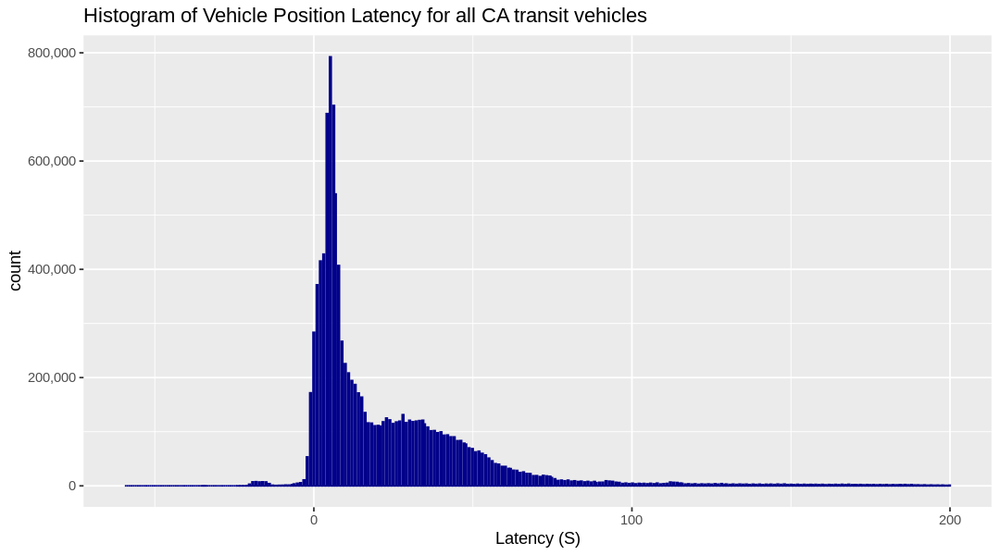

In [60]:
options(repr.plot.width = 9, repr.plot.height =5) 
Report1105 %>% 
    filter(VPLatency <= 200) %>% 
    ggplot(aes(VPLatency)) +
    geom_histogram(bins = 500, color = 'darkblue') +
    ggtitle("Histogram of Vehicle Position Latency for all CA transit vehicles") +
    xlab("Latency (S)") +
    scale_y_continuous(labels = scales::comma) 
              

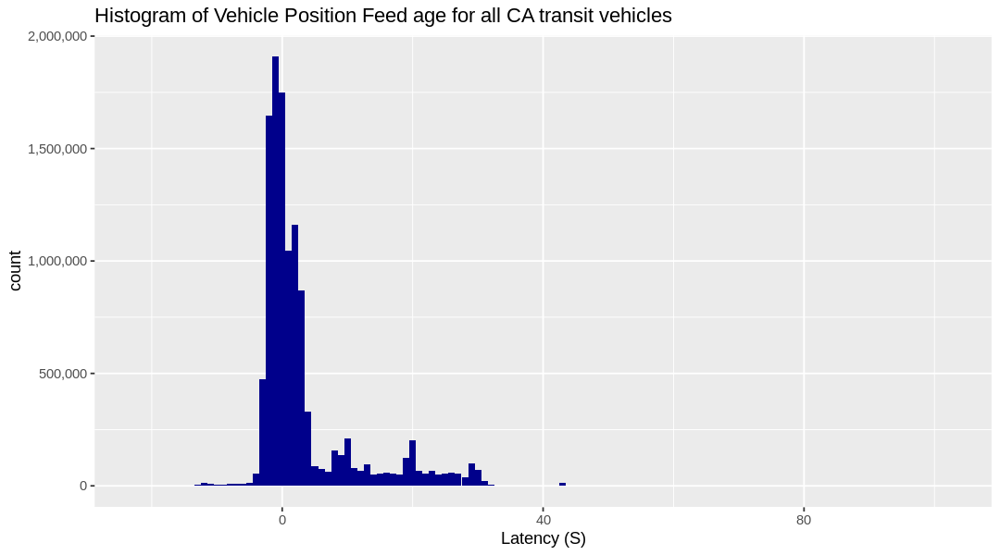

In [61]:
options(repr.plot.width = 9, repr.plot.height =5) 
Report1105 %>% 
    # filter(Latency <= 150) %>% 
    ggplot(aes(HLatency)) +
    geom_histogram(binwidth = 1, fill = 'darkblue') +
    ggtitle("Histogram of Vehicle Position Feed age for all CA transit vehicles") +
    xlab("Latency (S)") +
    scale_y_continuous(labels = scales::comma) 
              

In [65]:
Report1105 %>%
    distinct(Agency, Header_Timestamp, HLatency) %>%
    pull(HLatency) %>% 
    summary()

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-22.000  -1.000   0.000   3.571   4.000 102.000 

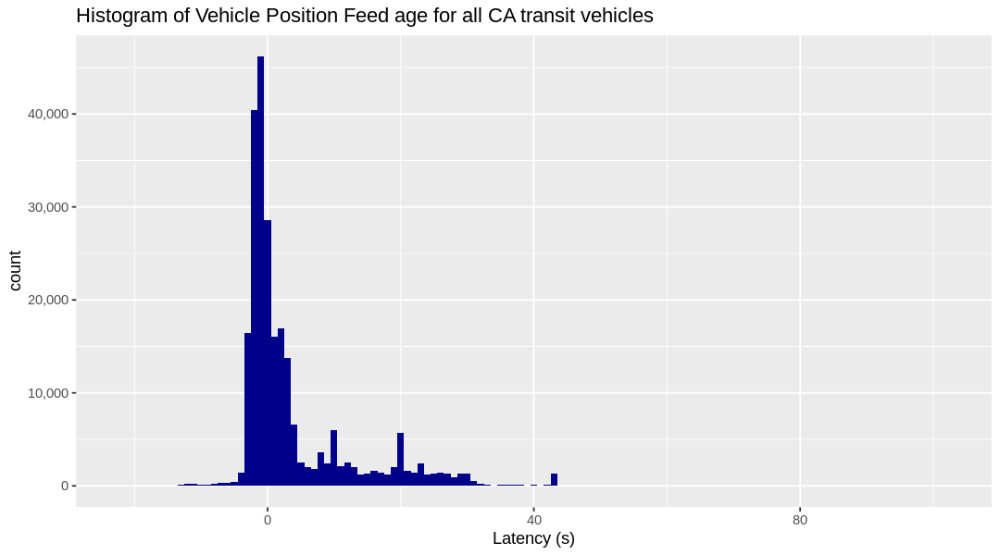

In [36]:
options(repr.plot.width = 9, repr.plot.height =5) 
Report1105 %>%
    distinct(Agency, Header_Timestamp, HLatency) %>% 
    ggplot(aes(HLatency)) +
    geom_histogram(binwidth = 1, fill = 'darkblue') +
    ggtitle("Histogram of Vehicle Position Feed age for all CA transit vehicles") +
    xlab("Latency (s)") +
    scale_y_continuous(labels = scales::comma) 


In [37]:
summary(Report1105$HLatency)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-22.000  -1.000   0.000   3.211   3.000 102.000 

### Before the bug fix 

In [67]:
options(repr.plot.width = 9, repr.plot.height =5) 
Report1105 %>% 
    distinct(
        Agency,
        HLatency,
        VPLatency) %>% 
    pull(VPLatency) %>% 
    summary()
    # filter(VPLatency <= 200) %>% 
    # ggplot(aes(VPLatency)) +
    # geom_histogram(bins = 500, color = 'darkblue') +
    # ggtitle("Histogram of Vehicle Position Latency for all CA transit vehicles") +
    # xlab("Latency (S)") +
    # scale_y_continuous(labels = scales::comma) 
              

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    -59      82     340   46816    6854 6699519 

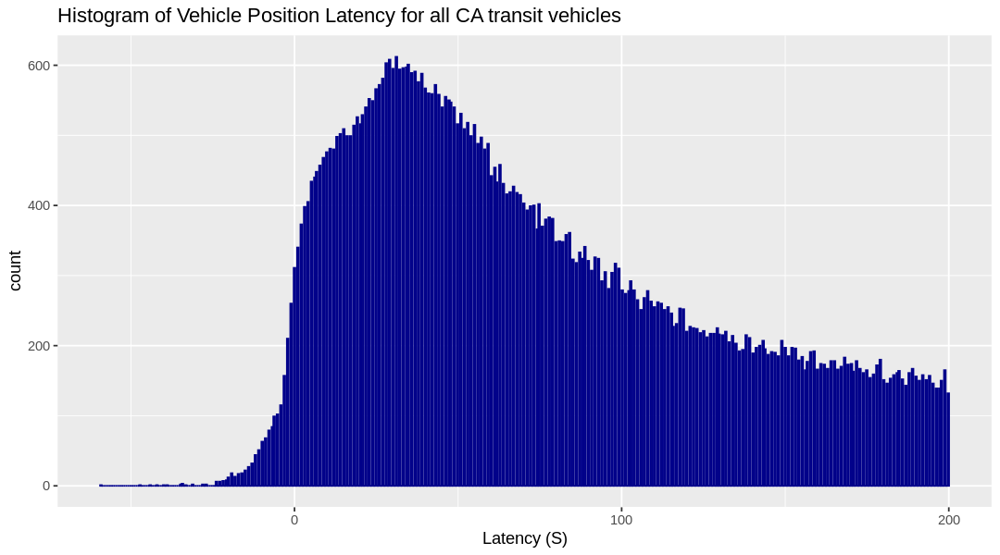

In [11]:
options(repr.plot.width = 9, repr.plot.height =5) 
Report1105 %>% 
    distinct(
        Agency,
        HLatency,
        VPLatency) %>% 
    filter(VPLatency <= 200) %>% 
    ggplot(aes(VPLatency)) +
    geom_histogram(bins = 500, color = 'darkblue') +
    ggtitle("Histogram of Vehicle Position Latency for all CA transit vehicles") +
    xlab("Latency (S)") +
    scale_y_continuous(labels = scales::comma) 
              

In [38]:
ReportS = Report1105 %>%
    group_by(Agency) %>% 
    summarize(Min = min(VPLatency), 
              `%25` = quantile(VPLatency, .25),
              Median = median(VPLatency), 
              Average = round(mean(VPLatency), 1),
              `%75` = quantile(VPLatency, .75),
              Max = max(VPLatency),
             )


In [40]:
ReportS$Agency= ReportS$Agency %>% str_replace(" Vehicle Positions", "")
ReportS$Agency= ReportS$Agency %>% str_replace(" Vehicle Position", "")
ReportS$Agency= ReportS$Agency %>% str_replace(" VehiclePositions", "")
ReportS$Agency= ReportS$Agency %>% str_replace(" VehiclePosition", "")
ReportS %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 10, dom = 'tp'),
              caption = 'Vehicle Position Message Statistics by Transit Agency'
             )


HTML widgets cannot be represented in plain text (need html)

In [44]:
# temp %>%
#     group_by(Agency) %>% 
#     summarize(Min = min(VPLatency), 
#               `%25` = quantile(VPLatency, .25),
#               Median = median(VPLatency), 
#               Average = round(mean(VPLatency), 1),
#               `%75` = quantile(VPLatency, .75),
#               Max = max(VPLatency),
#              ) %>% 
#     datatable(class = 'cell-border stripe', 
#               options = list(pageLength = 100, dom = 't'),
#               caption = 'Vehicle Position Message Statistics by Transit Agency'
#              )


In [45]:
# temp %>% filter(Agency == "San Pedro Trolley Vehicle Positions")

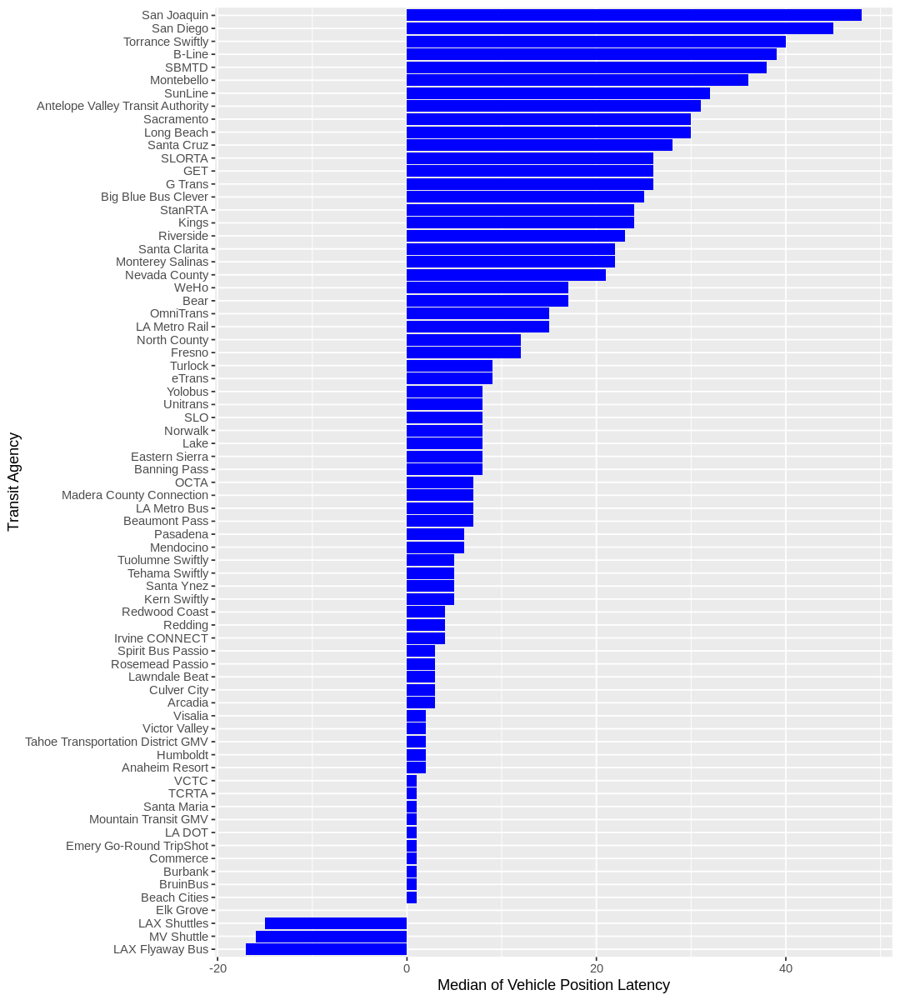

In [47]:
options(repr.plot.width = 9, repr.plot.height =10) 
ReportS %>% 
    filter(
        Median < 100,
        # Median > 0
        ) %>% 
    ggplot(aes(reorder(Agency, Median), Median)) +
    geom_bar(stat = 'identity', fill = "blue") +
    xlab("Transit Agency") +
    ylab("Median of Vehicle Position Latency") +
    # theme(axis.text.x = element_text(angle = 90)) +
    coord_flip()


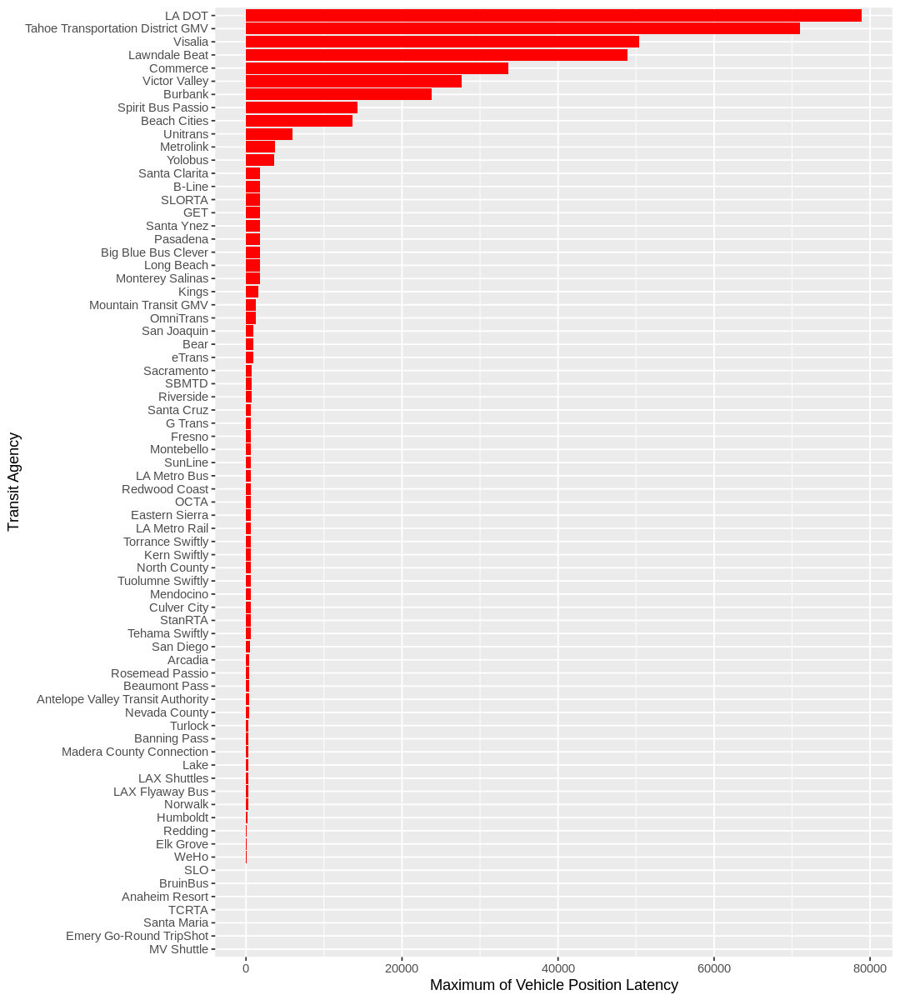

In [49]:
ReportS %>% 
    filter(
        Max < 100000,
        # Max > 10
        ) %>% 
    ggplot(aes(reorder(Agency, Max), Max)) +
    geom_bar(stat = 'identity', fill = "red") +
    xlab("Transit Agency") +
    ylab("Maximum of Vehicle Position Latency") +
    # theme(axis.text.x = element_text(angle = 90)) +
    coord_flip()


# Vendors

In [16]:
Vendors = c(
    "Avail Technologies Inc.",
    "Cal-ITP",
    "Clever Devices Ltd.",
    "Connexionz Inc.",
    "Cubic",
    "GMV Syncromatics Inc",
    "Passio Technologies",
    "Swiftly Inc.",
    "TransLoc",
    "TripShot Inc.",
    "TripSpark"
    )


In [17]:
ReportS2 = Report1105 %>%
    mutate(Vendor = str_replace(Vendor, "California Integrated Travel Project", "Cal-ITP"))  %>%
    filter(Vendor %in% Vendors) %>% 
    group_by(Vendor) %>% 
    summarize(Min = min(VPLatency), 
              `%25` = quantile(VPLatency, .25),
              Median = median(VPLatency), 
              `%75` = quantile(VPLatency, .75),
              `%90` = quantile(VPLatency, .90),
              `%95` = quantile(VPLatency, .95),
              Max = max(VPLatency),
             )
ReportS2 %>%     
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Vehicle Position Message Latency Statistics by Vendors', rownames = FALSE
             )


HTML widgets cannot be represented in plain text (need html)

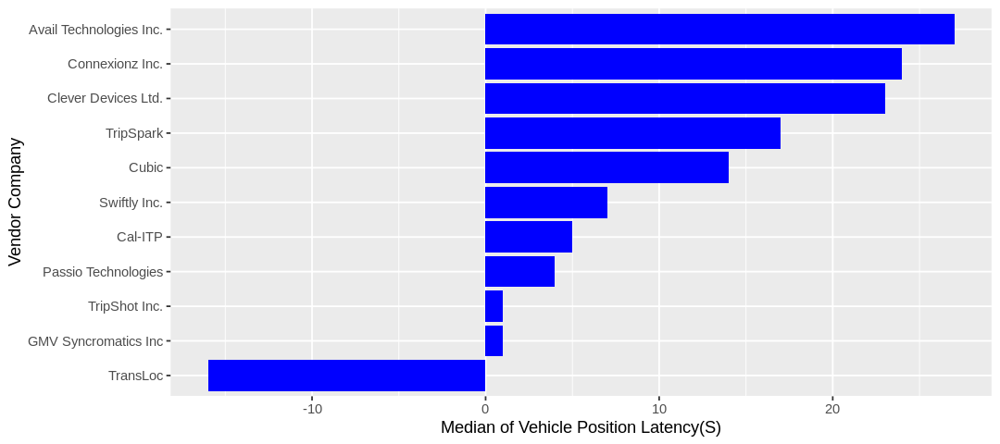

In [18]:
options(repr.plot.width = 9, repr.plot.height =4) 
ReportS2 %>% 
    # filter(
    #     Median < 1000,
    #     # Median > 0
    #     ) %>% 
    ggplot(aes(reorder(Vendor, Median), Median)) +
    geom_bar(stat = 'identity', fill = "blue") +
    xlab("Vendor Company") +
    ylab("Median of Vehicle Position Latency(S)") +
    # theme(axis.text.x = element_text(angle = 90)) +
    coord_flip()


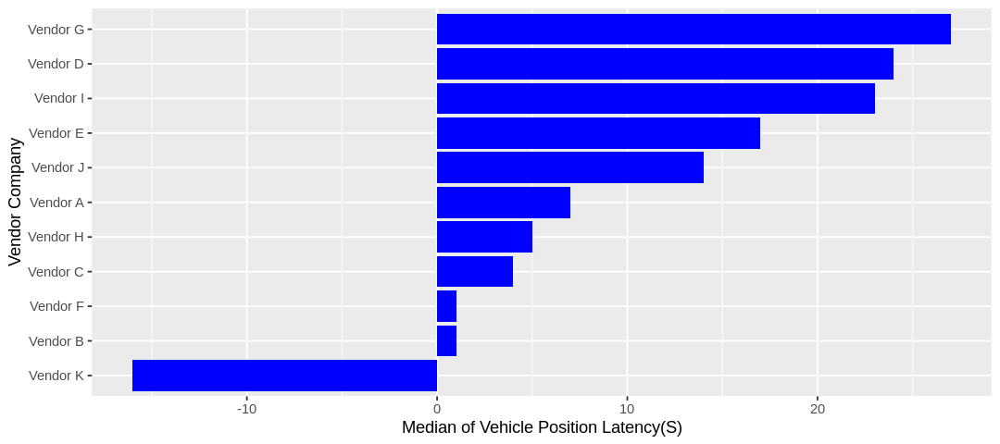

In [22]:
options(repr.plot.width = 9, repr.plot.height =4) 
ReportS2 %>% 
    mutate(Vendor = str_replace(Vendor, "Avail Technologies Inc.", "Vendor G")) %>%
    mutate(Vendor = str_replace(Vendor, "Cal-ITP", "Vendor H")) %>%
    mutate(Vendor = str_replace(Vendor, "Clever Devices Ltd.", "Vendor I")) %>%
    mutate(Vendor = str_replace(Vendor, "Connexionz Inc.", "Vendor D")) %>%
    mutate(Vendor = str_replace(Vendor, "Cubic", "Vendor J")) %>%
    mutate(Vendor = str_replace(Vendor, "GMV Syncromatics Inc", "Vendor B")) %>%
    mutate(Vendor = str_replace(Vendor, "Passio Technologies", "Vendor C")) %>%
    mutate(Vendor = str_replace(Vendor, "Swiftly Inc.", "Vendor A")) %>%
    mutate(Vendor = str_replace(Vendor, "TransLoc", "Vendor K")) %>%
    mutate(Vendor = str_replace(Vendor, "TripShot Inc.", "Vendor F")) %>%
    mutate(Vendor = str_replace(Vendor, "TripSpark", "Vendor E")) %>%
    # filter(
    #     Median < 1000,
    #     # Median > 0
    #     ) %>% 
    ggplot(aes(reorder(Vendor, Median), Median)) +
    geom_bar(stat = 'identity', fill = "blue") +
    xlab("Vendor Company") +
    ylab("Median of Vehicle Position Latency(S)") +
    # theme(axis.text.x = element_text(angle = 90)) +
    coord_flip()


In [54]:
ReportS2H = Report1105 %>%
    mutate(Vendor = str_replace(Vendor, "California Integrated Travel Project", "Cal-ITP"))  %>%
    filter(Vendor %in% Vendors) %>% 
    group_by(Vendor) %>% 
    summarize(Min = min(HLatency), 
              `%25` = quantile(HLatency, .25),
              Median = median(HLatency), 
              `%75` = quantile(HLatency, .75),
              `%95` = quantile(HLatency, .95),
              Max = max(HLatency),
             )
ReportS2H %>%     
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = FALSE
             )


HTML widgets cannot be represented in plain text (need html)

In [59]:
Report1105 %>% 
    filter(Vendor == "TripSpark",
           Agency == "B-Line Vehicle Positions",
           vehicle_label == "2004") %>% 
    arrange(extract_ts_pasific) %>% 
    head()

Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>
TripSpark,B-Line Vehicle Positions,2024-10-22 05:52:00,23,2024-10-22 05:51:37,25,2024-10-22 05:51:35,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72794,-121.8425,2bf2681e-2505-4404-9e0b-e992f562bd2c
TripSpark,B-Line Vehicle Positions,2024-10-22 05:52:20,43,2024-10-22 05:51:37,45,2024-10-22 05:51:35,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72794,-121.8425,2bf2681e-2505-4404-9e0b-e992f562bd2c
TripSpark,B-Line Vehicle Positions,2024-10-22 05:52:40,33,2024-10-22 05:52:07,51,2024-10-22 05:51:49,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72834,-121.8429,2bf2681e-2505-4404-9e0b-e992f562bd2c
TripSpark,B-Line Vehicle Positions,2024-10-22 05:53:00,23,2024-10-22 05:52:37,28,2024-10-22 05:52:32,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72889,-121.8424,2bf2681e-2505-4404-9e0b-e992f562bd2c
TripSpark,B-Line Vehicle Positions,2024-10-22 05:53:20,43,2024-10-22 05:52:37,48,2024-10-22 05:52:32,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72889,-121.8424,2bf2681e-2505-4404-9e0b-e992f562bd2c
TripSpark,B-Line Vehicle Positions,2024-10-22 05:53:40,33,2024-10-22 05:53:07,53,2024-10-22 05:52:47,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72882,-121.8420,2bf2681e-2505-4404-9e0b-e992f562bd2c


In [8]:
Report10272 %>% 
    filter(Agency == "Irvine CONNECT Vehicle Positions",
           Vendor == "Passio Technologies") %>%
    arrange(desc(VPLatency))


Vendor,Agency,extract_ts_pasific,HLatency,VPLatency,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id
<chr>,<chr>,<dttm>,<int>,<int>,<chr>,<chr>,<dbl>,<dbl>,<chr>
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:00:20,2,6699519,6376,15557,33.69547,-117.781,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:00:00,2,6699499,6376,15557,33.69547,-117.781,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 19:59:40,-1,6699479,6376,15557,33.69547,-117.781,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 19:59:20,2,6699459,6376,15557,33.69547,-117.781,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 14:57:00,-1,6681319,6376,15557,33.69547,-117.781,652028
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 14:56:40,2,6681299,6376,15557,33.69547,-117.781,652028
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 14:56:20,-3,6681279,6376,15557,33.69547,-117.781,652028
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 14:56:00,-3,6681259,6376,15557,33.69547,-117.781,652028
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 14:55:40,-2,6681239,6376,15557,33.69547,-117.781,652028


In [10]:
Report10272 %>% 
    filter(Agency == "Irvine CONNECT Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "15557") %>%
    arrange(desc(extract_ts_pasific)) #%>% 
    # as_tibble() %>% 
    # print(n = Inf)



Vendor,Agency,extract_ts_pasific,HLatency,VPLatency,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id
<chr>,<chr>,<dttm>,<int>,<int>,<chr>,<chr>,<dbl>,<dbl>,<chr>
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:03:40,-1,2,6376,15557,33.65620,-117.7334,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:03:20,1,7,6376,15557,33.65614,-117.7324,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:03:00,-2,1,6376,15557,33.65670,-117.7331,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:02:40,-1,107,6376,15557,33.65688,-117.7329,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:02:20,1,87,6376,15557,33.65688,-117.7329,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:02:00,-1,67,6376,15557,33.65688,-117.7329,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:01:40,-2,47,6376,15557,33.65688,-117.7329,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:01:20,3,27,6376,15557,33.65688,-117.7329,652033
Passio Technologies,Irvine CONNECT Vehicle Positions,2024-10-22 20:01:00,-1,7,6376,15557,33.65688,-117.7329,652033


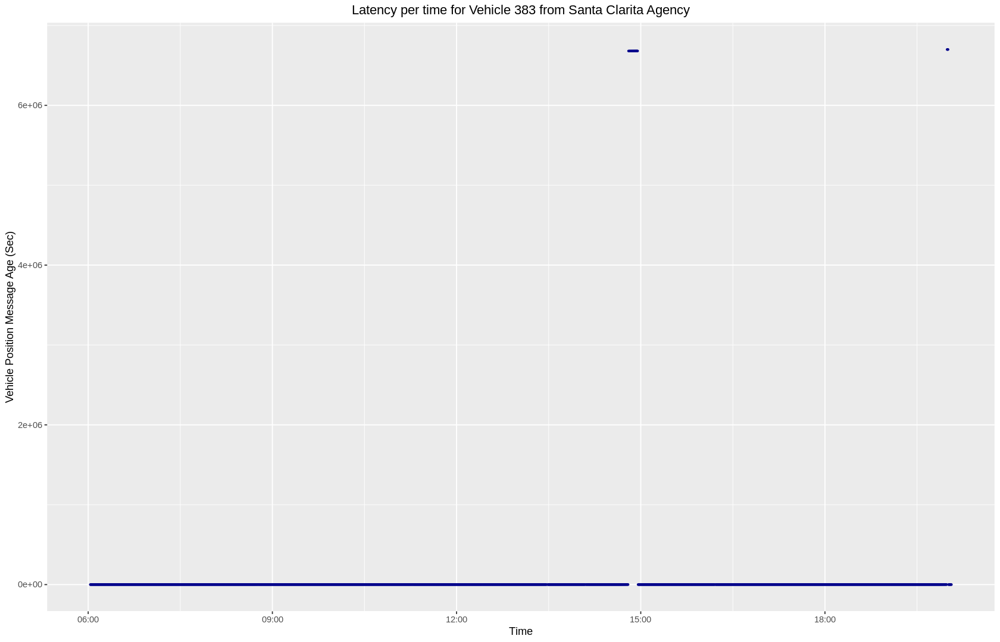

In [11]:
options(repr.plot.width = 14, repr.plot.height =9) 
Report10272 %>% 
    filter(Agency == "Irvine CONNECT Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "15557") %>%
    ggplot(aes(extract_ts_pasific, VPLatency)) +
    geom_point(size = .5, color = "darkblue") +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle 383 from Santa Clarita Agency") +
    theme(plot.title = element_text(hjust = 0.5)) 


In [25]:
glimpse(Report10272)

Rows: 15,920,151
Columns: 10
$ Vendor             <chr> "Swiftly Inc.", "Swiftly Inc.", "Swiftly Inc.", "Sw…
$ Agency             <chr> "OCTA VehiclePositions", "OCTA VehiclePositions", "…
$ extract_ts_pasific <dttm> 2024-10-22 21:47:40, 2024-10-22 21:47:40, 2024-10-…
$ HLatency           <int> -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,…
$ VPLatency          <int> 2, 11, 4, 4, 5, 8, 11, 11, 6, 8, 10, 2, 10, 75, 2, …
$ vehicle_label      <chr> "5836", "2216", "5733", "5856", "2253", "5755", "22…
$ vehicle_id         <chr> "5836", "2216", "5733", "5856", "2253", "5755", "22…
$ position_latitude  <dbl> 33.85728, 33.75985, 33.79300, 33.85715, 33.76014, 3…
$ position_longitude <dbl> -117.8912, -117.8561, -117.8356, -117.8909, -117.87…
$ trip_id            <chr> NA, "11492457", "11499297", NA, "11492496", "115744…


In [27]:
Report10272 %>% 
    filter(Agency == "Irvine CONNECT Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "15557",
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1,
           Time = format(extract_ts_pasific, format = "%H:%M:%S")
          ) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )



HTML widgets cannot be represented in plain text (need html)

In [30]:
Report10272 %>% 
    filter(Agency == "Irvine CONNECT Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "15557",
           format(extract_ts_pasific, format = "%H:%M:%S") > "14:40:00",
           format(extract_ts_pasific, format = "%H:%M:%S") < "15:00:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

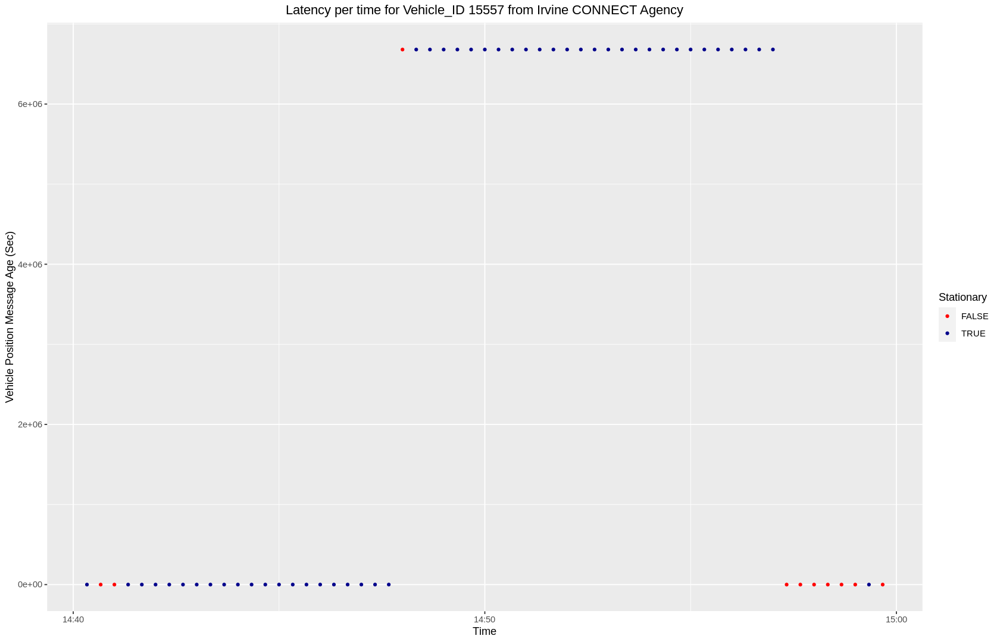

In [49]:
Report10272 %>% 
    filter(Agency == "Irvine CONNECT Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "15557",
           format(extract_ts_pasific, format = "%H:%M:%S") > "14:40:00",
           format(extract_ts_pasific, format = "%H:%M:%S") < "15:00:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    ggplot(aes(extract_ts_pasific, VPLatency)) +
    geom_point(size = 1.1, aes(color = Stationary)) +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle_ID 15557 from Irvine CONNECT Agency") +
    theme(plot.title = element_text(hjust = 0.5)) +
    scale_color_manual(values = c("red", "darkblue")) +
    scale_shape_manual(values = c(3, 16)) +
    scale_x_datetime( breaks = scales::date_breaks("10 min"), 
                    labels = scales::date_format("%H:%M", 
                                         # tz="CET"
                                        ), 
                    # expand = c(0,0)
                    )



In [63]:
query1105 = "
with 
cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
  vpm.gtfs_dataset_key,
  gtfs_dataset_name Agency,
  datetime(_extract_ts, 'America/Los_Angeles') extract_ts_pasific, 
  _header_message_age HLatency,
  _vehicle_message_age VPLatency,
  header_timestamp,  
  vehicle_timestamp,
  vehicle_label,
  vehicle_id,
  position_latitude,
  position_longitude,
  trip_id
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1
on vpm.gtfs_dataset_key = cte1.gtfs_dataset_key
where gtfs_dataset_name not like 'Bay Area 511%'
and dt between '2024-10-22' and '2024-10-23'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-10-22'
and _vehicle_message_age is not null
),
cte3 as(
select  
  organization_name Vendor,
  Agency,
  extract_ts_pasific, 
  HLatency,
  datetime(header_timestamp, 'America/Los_Angeles') as Header_Timestamp,
  VPLatency,
  datetime(vehicle_timestamp, 'America/Los_Angeles') as Vehicle_Timestamp,
  vehicle_label,
  vehicle_id,
  position_latitude,
  position_longitude,
  trip_id
from cte2 
inner join `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` bo
on cte2.gtfs_dataset_key = bo.gtfs_dataset_key
and '2024-10-22' between date(datetime(_valid_from, 'America/Los_Angeles')) 
and date(datetime(_valid_to, 'America/Los_Angeles'))
)

select * from cte3 
"
Report1105 = dbGetQuery(con, query1105)
Report1105 %>% 
    saveRDS("data/Report1105.rds")


### Irvine CONNECT Passio

In [64]:
Report1105 %>% 
    filter(Agency == "Irvine CONNECT Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "15557",
           format(extract_ts_pasific, format = "%H:%M:%S") > "14:40:00",
           format(extract_ts_pasific, format = "%H:%M:%S") < "15:00:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 20, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

### Spirit Bus - Passio

In [47]:
Report1105 %>% 
    filter(Agency == "Spirit Bus Passio Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "12310",
           format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

<ScaleContinuousDatetime>
 Range:  
 Limits:    0 --    1

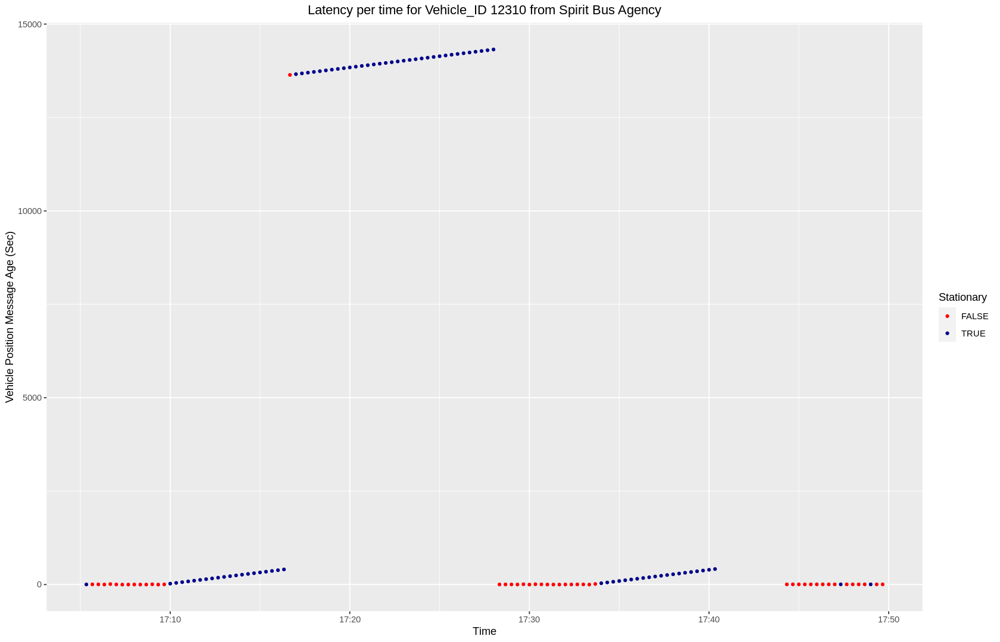

In [48]:
Report1105 %>% 
    filter(Agency == "Spirit Bus Passio Vehicle Positions",
           Vendor == "Passio Technologies",
           vehicle_id == "12310",
           format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    ggplot(aes(extract_ts_pasific, VPLatency)) +
    geom_point(size = 1.1, aes(color = Stationary)) +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle_ID 12310 from Spirit Bus Agency") +
    theme(plot.title = element_text(hjust = 0.5)) +
    scale_color_manual(values = c("red", "darkblue")) +
    scale_shape_manual(values = c(3, 16)) #+
    scale_x_datetime( breaks = scales::date_breaks("10 min"), 
                    labels = scales::date_format("%H:%M", 
                                         # tz="CET"
                                        ), 
                    # expand = c(0,0)
                    )



## Yolobus TripSpark

In [52]:
Report1105 %>% 
    filter(Agency == "Yolobus Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "5703",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

<ScaleContinuousDatetime>
 Range:  
 Limits:    0 --    1

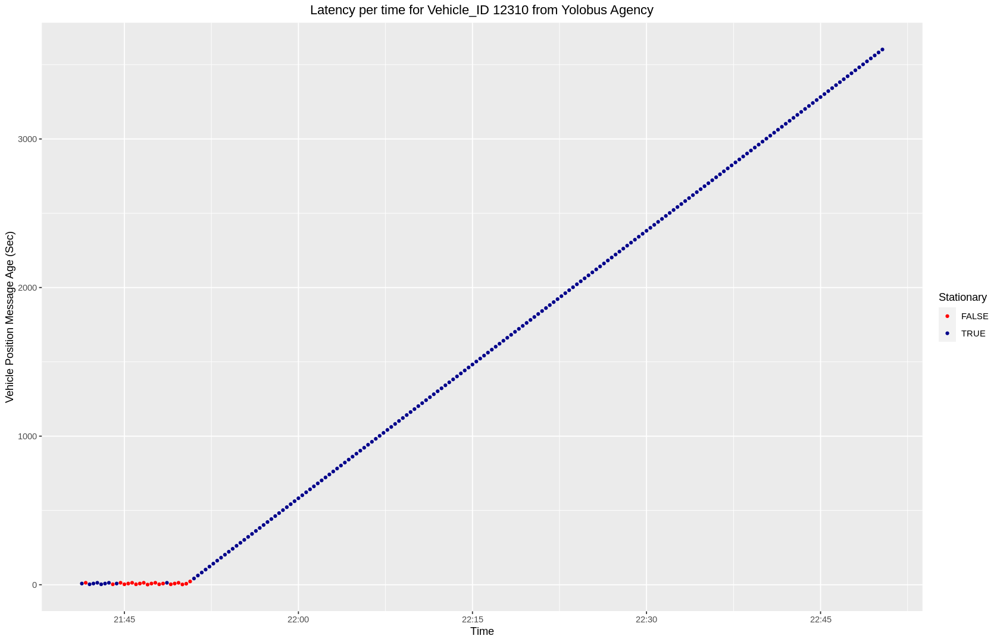

In [67]:
Report1105 %>% 
    filter(Agency == "Yolobus Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "5703",
           format(extract_ts_pasific, format = "%H:%M:%S") > "21:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    ggplot(aes(extract_ts_pasific, VPLatency)) +
    geom_point(size = 1.1, aes(color = Stationary)) +
    xlab("Time") +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle_ID 12310 from Yolobus Agency") +
    theme(plot.title = element_text(hjust = 0.5)) +
    scale_color_manual(values = c("red", "darkblue")) +
    scale_shape_manual(values = c(3, 16)) #+
    scale_x_datetime( breaks = scales::date_breaks("10 min"), 
                    labels = scales::date_format("%H:%M", 
                                         # tz="CET"
                                        ), 
                    # expand = c(0,0)
                    )



## BruinBus - TripShot

In [65]:
Report1105 %>% 
    filter(Agency == "BruinBus Vehicle Positions",
           # Vendor == "Passio Technologies",
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(trip_id, extract_ts_pasific) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


Warning message in instance$preRenderHook(instance):
“It seems your data is too big for client-side DataTables. You may consider server-side processing: https://rstudio.github.io/DT/server.html”


HTML widgets cannot be represented in plain text (need html)

In [68]:
Report1105 %>% 
    filter(Agency == "BruinBus Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    distinct(trip_id) 


trip_id
<chr>
153abc32-7155-4077-b924-594d958a9f06
57606c91-dbe5-42d8-88c6-8d577ce78a2d
85262250-a471-41d9-b73a-51774b20405c
78da82db-078a-4da9-b7e7-c595bc2a6b37
dc4329c8-ef17-462e-acba-325c7f606e7b
d66abe94-5701-4dfe-923a-afb1c5bfe826
0f59d0ab-bd54-4bf8-841e-f7ed82cfc688
b2cd5c81-279a-4197-acbf-0ccd64146abb
df74167b-ad62-4fce-b2ff-97cf8b12d548


### Redding - Swiftly

In [69]:
Report1105 %>% 
    filter(Agency == "Redding Vehicle Positions",
           # Vendor == "Passio Technologies",
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(trip_id, extract_ts_pasific) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


Warning message in instance$preRenderHook(instance):
“It seems your data is too big for client-side DataTables. You may consider server-side processing: https://rstudio.github.io/DT/server.html”


HTML widgets cannot be represented in plain text (need html)

In [9]:
Report1105 %>% 
    filter(#Agency == "Redding Vehicle Positions",
           Vendor == "Swiftly Inc.",
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    group_by(`Swiftly Agencies` = Agency) %>% 
    summarise(`VP Feed Creation Freq.` = max(HLatency))
    # arrange(trip_id, extract_ts_pasific) %>% 
    # datatable(class = 'cell-border stripe', 
    #           options = list(pageLength = 98, dom = 'tp'),
    #           caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
    #          )


Swiftly Agencies,VP Feed Creation Freq.
<chr>,<int>
Banning Pass Vehicle Positions,5
Beaumont Pass Vehicle Positions,5
Eastern Sierra Vehicle Positions,5
Humboldt Vehicle Positions,5
Kern Swiftly Vehicle Position,5
LA Metro Bus Vehicle Positions,102
LA Metro Rail Vehicle Positions,60
Lake Vehicle Positions,5
Madera County Connection Vehicle Positions,5


In [12]:
Report1105 %>% 
    filter(Agency == "LA Metro Bus Vehicle Positions",
           HLatency == 102,
           !is.na(trip_id)
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          )# %>%
   # distinct(vehicle_id) 


Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,105,2024-10-22 02:59:55,4139,4139,34.06265,-118.0671,10070003032608-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,104,2024-10-22 02:59:56,4178,4178,34.03808,-118.2603,10030008222640-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,108,2024-10-22 02:59:52,1982,1982,34.08078,-118.0727,10076002162605-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,106,2024-10-22 02:59:54,6016,6016,34.01652,-118.4953,10020008132547-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,104,2024-10-22 02:59:56,6025,6025,34.09791,-118.3390,10002011392630-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,105,2024-10-22 02:59:55,5618,5618,34.06714,-118.3998,10020008292633-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,106,2024-10-22 02:59:54,5691,5691,33.76807,-118.1909,10060001812700-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,150,2024-10-22 02:59:10,8764,8764,34.09083,-118.3668,10004003722604-JUNE24
Swiftly Inc.,LA Metro Bus Vehicle Positions,2024-10-22 03:01:40,102,2024-10-22 02:59:58,105,2024-10-22 02:59:55,8780,8780,34.02030,-118.4040,10033006802636-JUNE24


In [13]:
Report1105 %>% 
    filter(Agency == "LA Metro Bus Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_id == "4139",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(trip_id, extract_ts_pasific) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

In [34]:
test1 = Report1105 %>% 
     mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    filter(Agency == "LA Metro Bus Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "4139",
           !Stationary,
           format(extract_ts_pasific, format = "%H:%M:%S") > "08:00:00",
           format(extract_ts_pasific, format = "%H:%M:%S") < "09:15:00"           
          ) 


In [36]:
summary(test1)

    Vendor             Agency          extract_ts_pasific           
 Length:224         Length:224         Min.   :2024-10-22 08:00:20  
 Class :character   Class :character   1st Qu.:2024-10-22 08:18:55  
 Mode  :character   Mode  :character   Median :2024-10-22 08:37:30  
                                       Mean   :2024-10-22 08:37:30  
                                       3rd Qu.:2024-10-22 08:56:05  
                                       Max.   :2024-10-22 09:14:40  
    HLatency       Header_Timestamp                VPLatency    
 Min.   :-3.0000   Min.   :2024-10-22 08:00:21   Min.   : 1.00  
 1st Qu.: 0.0000   1st Qu.:2024-10-22 08:18:54   1st Qu.: 7.00  
 Median : 1.0000   Median :2024-10-22 08:37:30   Median :18.00  
 Mean   : 0.6295   Mean   :2024-10-22 08:37:29   Mean   :19.85  
 3rd Qu.: 2.0000   3rd Qu.:2024-10-22 08:56:01   3rd Qu.:29.00  
 Max.   : 4.0000   Max.   :2024-10-22 09:14:41   Max.   :56.00  
 Vehicle_Timestamp             vehicle_label       vehicle_id 

<ScaleContinuousDatetime>
 Range:  
 Limits:    0 --    1

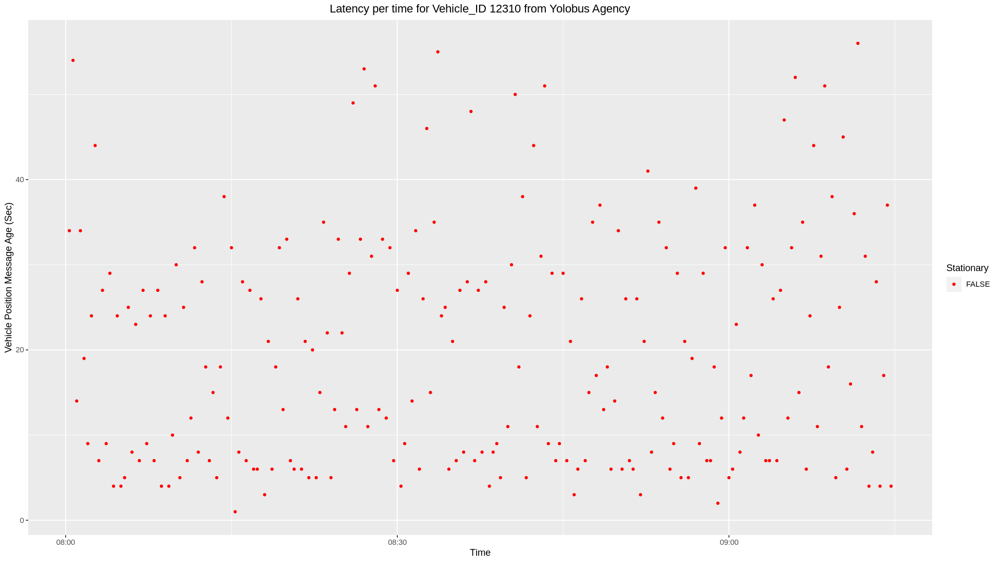

In [38]:
options(repr.plot.width = 16, repr.plot.height =9) 
test1 %>% 
    # filter(Agency == "LA Metro Bus Vehicle Positions",
    #        # Vendor == "Passio Technologies",
    #        # vehicle_label == "4139",
    #        format(extract_ts_pasific, format = "%H:%M:%S") > "08:00:00",
    #        format(extract_ts_pasific, format = "%H:%M:%S") < "09:00:00"           
    #       ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    # mutate(`On Trip` = !is.na(trip_id),
    #        location = position_latitude + position_longitude, 
    #        location1 = lead(location, default = last(location)),
    #        Stationary = location == location1) %>% 
    ggplot(aes(extract_ts_pasific, VPLatency)) +
    geom_point(size = 1.1, 
               aes(color = Stationary)
              ) +
    xlab("Time") +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle_ID 12310 from Yolobus Agency") +
    theme(plot.title = element_text(hjust = 0.5)) +
    scale_color_manual(values = c("red", "darkblue")) +
    scale_shape_manual(values = c(3, 16)) #+
    scale_x_datetime( breaks = scales::date_breaks("10 min"), 
                    labels = scales::date_format("%H:%M", 
                                         # tz="CET"
                                        ), 
                    # expand = c(0,0)
                    )



### GMV Syncromatic

In [6]:
Report1105 %>% 
    filter(#Agency == "Redding Vehicle Positions",
           Vendor == "GMV Syncromatics Inc",
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00" 
            # is.na(trip_id
          ) %>%
    summary()
    # group_by(`Swiftly Agencies` = Agency) %>% 
    # summarise(`VP Feed Creation Freq.` = max(HLatency))
    # arrange(trip_id, extract_ts_pasific) %>% 
    # datatable(class = 'cell-border stripe', 
    #           options = list(pageLength = 98, dom = 'tp'),
    #           caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
    #          )


    Vendor             Agency          extract_ts_pasific           
 Length:1063442     Length:1063442     Min.   :2024-10-22 00:00:00  
 Class :character   Class :character   1st Qu.:2024-10-22 09:06:40  
 Mode  :character   Mode  :character   Median :2024-10-22 13:15:20  
                                       Mean   :2024-10-22 13:04:57  
                                       3rd Qu.:2024-10-22 16:55:40  
                                       Max.   :2024-10-22 23:59:40  
    HLatency       Header_Timestamp                VPLatency      
 Min.   :-22.000   Min.   :2024-10-22 00:00:01   Min.   :    -19  
 1st Qu.: -3.000   1st Qu.:2024-10-22 09:06:43   1st Qu.:      0  
 Median : -2.000   Median :2024-10-22 13:15:27   Median :      1  
 Mean   : -2.499   Mean   :2024-10-22 13:04:59   Mean   :  15001  
 3rd Qu.: -1.000   3rd Qu.:2024-10-22 16:55:42   3rd Qu.:      2  
 Max.   :  0.000   Max.   :2024-10-22 23:59:43   Max.   :1837732  
 Vehicle_Timestamp             vehicle_label    

In [13]:
Report1105 %>% filter(!is.na(trip_id))  %>% is.na() %>% colSums()

Vendor             Agency extract_ts_pasific           HLatency 
                 0                  0                  0                  0 
  Header_Timestamp          VPLatency  Vehicle_Timestamp      vehicle_label 
                 0                  0                  0            2389023 
        vehicle_id  position_latitude position_longitude            trip_id 
            100309              63536              63536                  0

In [15]:
Report1105 %>% dim()

[1] 15920151       12

In [16]:
Report1105 %>% filter(!is.na(trip_id)) %>% dim()

[1] 11637818       12

In [17]:
15920151 - 11637818

[1] 4282333

In [40]:
Report1105 %>% 
    filter(#Agency == "Redding Vehicle Positions",
           Vendor == "GMV Syncromatics Inc",
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    group_by(`Swiftly Agencies` = Agency) %>% 
    summarise(`VP Feed Creation Freq.` = max(VPLatency))
    # arrange(trip_id, extract_ts_pasific) %>% 
    # datatable(class = 'cell-border stripe', 
    #           options = list(pageLength = 98, dom = 'tp'),
    #           caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
    #          )


Swiftly Agencies,VP Feed Creation Freq.
<chr>,<int>
Beach Cities VehiclePositions,13633
Burbank VehiclePositions,23764
Commerce VehiclePositions,33657
Desert Roadrunner Vehicle Positions,1160526
Elk Grove VehiclePositions,110
LA DOT VehiclePositions,78910
Lawndale Beat Vehicle Positions,48879
Merced VehiclePositions,236361
Mountain Transit GMV VehiclePositions,1306


In [41]:
Report1105 %>% 
    filter(Agency == "VCTC Vehicle Positions",
           VPLatency == 1837732,
           # vehicle_id == "4139",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(trip_id, extract_ts_pasific) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

In [51]:
test1 = Report1105 %>% 
     mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    filter(Agency == "VCTC Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "833",
           !Stationary,
           # format(extract_ts_pasific, format = "%H:%M:%S") > "08:00:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "09:15:00"           
          )  %>% 
    arrange(trip_id, extract_ts_pasific) #%>% 
    # datatable(class = 'cell-border stripe', 
    #           options = list(pageLength = 98, dom = 'tp'),
    #           caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
    #          )


In [52]:
summary(test1)

    Vendor             Agency          extract_ts_pasific           
 Length:4059        Length:4059        Min.   :2024-10-22 00:00:00  
 Class :character   Class :character   1st Qu.:2024-10-22 06:19:30  
 Mode  :character   Mode  :character   Median :2024-10-22 12:02:20  
                                       Mean   :2024-10-22 11:59:54  
                                       3rd Qu.:2024-10-22 17:44:10  
                                       Max.   :2024-10-22 23:59:40  
    HLatency       Header_Timestamp                VPLatency      
 Min.   :-22.000   Min.   :2024-10-22 00:00:01   Min.   :1751352  
 1st Qu.: -3.000   1st Qu.:2024-10-22 06:19:32   1st Qu.:1774122  
 Median : -2.000   Median :2024-10-22 12:02:21   Median :1794692  
 Mean   : -2.928   Mean   :2024-10-22 11:59:57   Mean   :1794546  
 3rd Qu.: -1.000   3rd Qu.:2024-10-22 17:44:11   3rd Qu.:1815202  
 Max.   :  0.000   Max.   :2024-10-22 23:59:42   Max.   :1837732  
 Vehicle_Timestamp             vehicle_label    

In [53]:
test1

Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id,On Trip,location,location1,Stationary
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<lgl>,<dbl>,<dbl>,<lgl>
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:00:00,-1,2024-10-22 00:00:01,1751352,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-84.72852,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:00:40,-4,2024-10-22 00:00:44,1751392,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-84.72852,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:01:00,-2,2024-10-22 00:01:02,1751412,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-85.02188,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:01:20,-1,2024-10-22 00:01:21,1751432,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-84.94423,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:01:40,-3,2024-10-22 00:01:43,1751452,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-84.94423,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:02:00,-4,2024-10-22 00:02:04,1751472,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-84.72852,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:02:20,-2,2024-10-22 00:02:22,1751492,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-85.02188,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:02:40,-1,2024-10-22 00:02:41,1751512,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-85.02188,FALSE
GMV Syncromatics Inc,VCTC Vehicle Positions,2024-10-22 00:03:00,-3,2024-10-22 00:03:03,1751532,2024-10-01 17:30:48,833,4731,34.21053,-119.0362,NA,FALSE,-84.82567,-84.94423,FALSE


<ScaleContinuousDatetime>
 Range:  
 Limits:    0 --    1

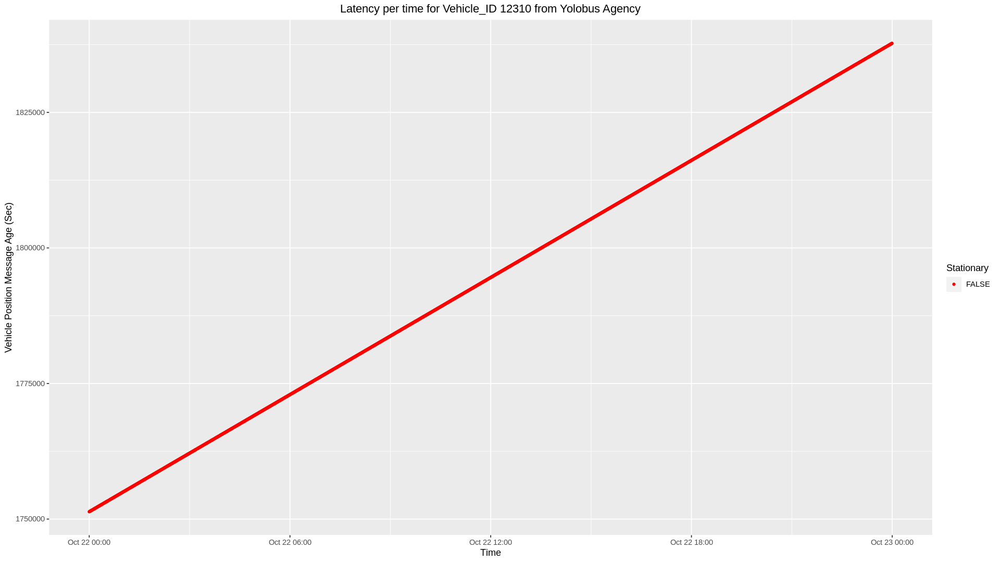

In [47]:
options(repr.plot.width = 16, repr.plot.height =9) 
test1 %>% 
    # filter(Agency == "LA Metro Bus Vehicle Positions",
    #        # Vendor == "Passio Technologies",
    #        # vehicle_label == "4139",
    #        format(extract_ts_pasific, format = "%H:%M:%S") > "08:00:00",
    #        format(extract_ts_pasific, format = "%H:%M:%S") < "09:00:00"           
    #       ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    # mutate(`On Trip` = !is.na(trip_id),
    #        location = position_latitude + position_longitude, 
    #        location1 = lead(location, default = last(location)),
    #        Stationary = location == location1) %>% 
    ggplot(aes(extract_ts_pasific, VPLatency)) +
    geom_point(size = 1.1, 
               aes(color = Stationary)
              ) +
    xlab("Time") +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle_ID 12310 from Yolobus Agency") +
    theme(plot.title = element_text(hjust = 0.5)) +
    scale_color_manual(values = c("red", "darkblue")) +
    scale_shape_manual(values = c(3, 16)) #+
    scale_x_datetime( breaks = scales::date_breaks("10 min"), 
                    labels = scales::date_format("%H:%M", 
                                         # tz="CET"
                                        ), 
                    # expand = c(0,0)
                    )



In [23]:
Report1105 %>% 
    filter(#Agency == "Redding Vehicle Positions",
           Vendor == "TripSpark",
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    group_by(`Swiftly Agencies` = Agency) %>% 
    summarise(`VP Feed Creation Freq.` = max(HLatency))
    # arrange(trip_id, extract_ts_pasific) %>% 
    # datatable(class = 'cell-border stripe', 
    #           options = list(pageLength = 98, dom = 'tp'),
    #           caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
    #          )


Swiftly Agencies,VP Feed Creation Freq.
<chr>,<int>
B-Line Vehicle Positions,53
Yolobus Vehicle Positions,19


In [31]:
Report1105 %>% 
    filter(Agency == "B-Line Vehicle Positions",
           HLatency == 53,
           !is.na(trip_id)
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) #%>%
#   distinct(vehicle_label) 


Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>
TripSpark,B-Line Vehicle Positions,2024-10-22 05:56:00,53,2024-10-22 05:55:07,106,2024-10-22 05:54:14,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72882,-121.8420,2bf2681e-2505-4404-9e0b-e992f562bd2c
TripSpark,B-Line Vehicle Positions,2024-10-22 05:59:00,53,2024-10-22 05:58:07,56,2024-10-22 05:58:04,2004,7804d064-252b-4790-bcfa-54d08ba5a29d,39.72541,-121.8350,2bf2681e-2505-4404-9e0b-e992f562bd2c
TripSpark,B-Line Vehicle Positions,2024-10-22 05:56:00,53,2024-10-22 05:55:07,58,2024-10-22 05:55:02,2003,04c37bcb-9aca-46ec-bf20-4872e64e1105,39.50956,-121.5530,09bd13c9-8273-4693-a205-939866333804
TripSpark,B-Line Vehicle Positions,2024-10-22 05:59:00,53,2024-10-22 05:58:07,58,2024-10-22 05:58:02,2003,04c37bcb-9aca-46ec-bf20-4872e64e1105,39.51672,-121.5499,09bd13c9-8273-4693-a205-939866333804


In [33]:
Report1105 %>% 
    filter(Agency == "B-Line Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "2004",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(trip_id, extract_ts_pasific) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

In [37]:
Report1105 %>% 
    filter(#Agency == "Redding Vehicle Positions",
           Vendor == "TripShot Inc.",
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"
           # !is.na(HLatency) 
          ) %>%
    group_by(`Swiftly Agencies` = Agency) %>% 
    summarise(`VP Feed Creation Freq.` = max(HLatency))
    # arrange(trip_id, extract_ts_pasific) %>% 
    # datatable(class = 'cell-border stripe', 
    #           options = list(pageLength = 98, dom = 'tp'),
    #           caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
    #          )


Swiftly Agencies,VP Feed Creation Freq.
<chr>,<int>
Anaheim Resort VehiclePositions,7
BruinBus Vehicle Positions,7
Emery Go-Round TripShot Vehicle Positions,4
Santa Maria Vehicle Positions,5
TCRTA Vehicle Positions,6


In [41]:
Report1105 %>% 
    filter(Agency == "BruinBus Vehicle Positions",
           # HLatency == 7,
           !is.na(trip_id)
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
  distinct(vehicle_label) 


vehicle_label
<chr>
4T28 ELECTRIC
4T19 CNG
4T21 CNG
32/4T20 ELECTRIC
33/405227 Electric
4T18 CNG
31/4T01 ELECTRIC
30/4C00 ELECTRIC
4T04 CNG


In [55]:
Report1105 %>% 
    filter(Agency == "BruinBus Vehicle Positions",
           HLatency == 7,
           !is.na(trip_id)
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(extract_ts_pasific) 

   # distinct(Header_Timestamp) 


Vendor,Agency,extract_ts_pasific,HLatency,Header_Timestamp,VPLatency,Vehicle_Timestamp,vehicle_label,vehicle_id,position_latitude,position_longitude,trip_id
<chr>,<chr>,<dttm>,<int>,<dttm>,<int>,<dttm>,<chr>,<chr>,<dbl>,<dbl>,<chr>
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,31/4T01 ELECTRIC,03f3225f-c513-4b1c-aad7-b3e465b7b259,34.05964,-118.4489,dc690211-a5c1-4244-bcb2-ba6cbd9e9313
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,4T19 CNG,e70e1134-32a5-4a04-ae31-5a900f4dd600,34.06932,-118.4404,717580c8-b40a-42c5-9e32-9dfb64c7b73b
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,30/4C00 ELECTRIC,21d05dbc-407d-4535-ba0b-25fe7726bce7,34.05979,-118.4449,0f59d0ab-bd54-4bf8-841e-f7ed82cfc688
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,4T27 CNG,61f1a35b-6b83-4709-841c-fc6641aebaec,34.07226,-118.4388,d9a4583d-7737-4b66-b1c3-2e3ccd8addf3
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,33/405227 Electric,4f0d637b-cabe-447d-b8bb-d3be255c366f,34.05965,-118.4488,5746a088-dd6c-495c-915a-5f66b804317f
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,4T22 CNG,fed42476-93ff-47a0-994d-07405586d93c,34.07218,-118.4383,4234926c-78f3-416a-a74f-e9a9885123ed
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,34/405228 Electric,77c5eef1-5e52-473a-8b29-0fa6fad3e1e8,34.06242,-118.4453,ac3ec30e-a761-4d9c-9988-431d8ba76899
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,32/4T20 ELECTRIC,0b9ed9a6-3bf0-4f73-8288-a9bd0c48c1d1,34.05927,-118.4487,a8b1f6e2-7833-4d56-91f5-c9310913d4bb
TripShot Inc.,BruinBus Vehicle Positions,2024-10-22 13:34:40,7,2024-10-22 13:34:33,7,2024-10-22 13:34:33,4T28 ELECTRIC,04754bfb-4b64-4175-b6a2-51f3d619eced,34.06723,-118.4452,e34a387c-4afc-4812-9f04-f5eea8d2fe96


In [44]:
Report1105 %>% 
    filter(Agency == "BruinBus Vehicle Positions",
           HLatency == 6,
           !is.na(trip_id)
           # vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
   distinct(Header_Timestamp) 


Header_Timestamp
<dttm>
2024-10-22 13:42:34
2024-10-22 15:15:54
2024-10-22 17:46:54
2024-10-22 14:41:14


In [51]:
Report1105 %>% 
    filter(Agency == "BruinBus Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "30/4C00 ELECTRIC",
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(trip_id, extract_ts_pasific) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

In [59]:
class(Report1105$Header_Timestamp)
as.POSIXct("2024-10-22 00:32:40", "PST")
Sys.timezone()

[1] "POSIXct" "POSIXt"

[1] "2024-10-22 00:32:40 PST"

[1] "Etc/UTC"

In [61]:
Report1105 %>% 
    filter(Agency == "BruinBus Vehicle Positions",
           # Vendor == "Passio Technologies",
           # vehicle_label == "30/4C00 ELECTRIC",
           Header_Timestamp == as.POSIXct("2024-10-22 13:34:33")
           # format(extract_ts_pasific, format = "%H:%M:%S") > "17:05:00",
           # format(extract_ts_pasific, format = "%H:%M:%S") < "17:50:00"           
          ) %>%
    arrange(extract_ts_pasific) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )


HTML widgets cannot be represented in plain text (need html)

<ScaleContinuousDatetime>
 Range:  
 Limits:    0 --    1

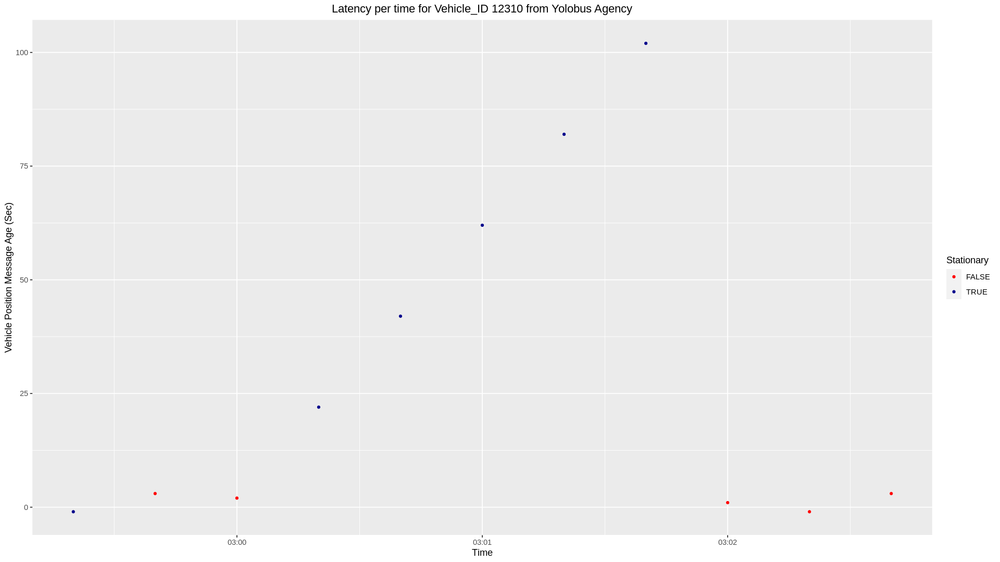

In [21]:
options(repr.plot.width = 16, repr.plot.height =9) 
Report1105 %>% 
    filter(Agency == "LA Metro Bus Vehicle Positions",
           # Vendor == "Passio Technologies",
           vehicle_label == "4139",
           format(extract_ts_pasific, format = "%H:%M:%S") > "02:59:00",
           format(extract_ts_pasific, format = "%H:%M:%S") < "03:03:00"           
          ) %>%
    arrange(desc(extract_ts_pasific)) %>% 
    mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    ggplot(aes(extract_ts_pasific, HLatency)) +
    geom_point(size = 1.1, aes(color = Stationary)) +
    xlab("Time") +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle_ID 12310 from Yolobus Agency") +
    theme(plot.title = element_text(hjust = 0.5)) +
    scale_color_manual(values = c("red", "darkblue")) +
    scale_shape_manual(values = c(3, 16)) #+
    scale_x_datetime( breaks = scales::date_breaks("10 min"), 
                    labels = scales::date_format("%H:%M", 
                                         # tz="CET"
                                        ), 
                    # expand = c(0,0)
                    )



In [135]:
santaClaritaDistinct = dbGetQuery(con,
"
with cte1 as(    
    SELECT *, first_value(_extract_ts) over(
      partition by 
        gtfs_dataset_key,
        dt,
        -- hour,
        base64_url,
        -- _extract_ts,
        -- _config_extract_ts,
        gtfs_dataset_name,
        schedule_gtfs_dataset_key,
        schedule_base64_url,
        schedule_name,
        schedule_feed_key,
        schedule_feed_timezone,
        -- COALESCE(
        --     trip_start_date,
        --     DATE(header_timestamp, schedule_feed_timezone),
        --     DATE(_extract_ts, schedule_feed_timezone)) AS service_date,

        -- TIMESTAMP_DIFF(_extract_ts, header_timestamp, SECOND) AS _header_message_age,
        -- TIMESTAMP_DIFF(_extract_ts, vehicle_timestamp, SECOND) AS _vehicle_message_age,
        -- TIMESTAMP_DIFF(header_timestamp, vehicle_timestamp, SECOND) AS _vehicle_message_age_vs_header,


        header_timestamp,
        header_version,
        header_incrementality,

        id,

        current_stop_sequence,
        stop_id,
        current_status,
        vehicle_timestamp,
        congestion_level,
        occupancy_status,
        occupancy_percentage,

        vehicle_id,
        vehicle_label,
        vehicle_license_plate,
        vehicle_wheelchair_accessible,

        trip_id,
        trip_route_id,
        trip_direction_id,
        trip_start_time,
        trip_start_time_interval,
        trip_start_date,
        trip_schedule_relationship,

        cast(position_latitude as string),
        cast(position_longitude as string),
        cast(position_bearing as string),
        cast(position_odometer as string),
        cast(position_speed as string)
      order by _extract_ts
    ) as new_extract_ts
    FROM`cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages`
    where dt between '2024-10-22' and '2024-10-23'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-10-22'
and gtfs_dataset_name = 'Santa Clarita VehiclePositions'
and vehicle_label = '282'
), 
cte2 as(
select distinct 
        gtfs_dataset_key,
        dt,
        -- hour,
        base64_url,
        new_extract_ts,
        -- _config_extract_ts,
        gtfs_dataset_name,
        schedule_gtfs_dataset_key,
        schedule_base64_url,
        schedule_name,
        schedule_feed_key,
        schedule_feed_timezone,
        COALESCE(
            trip_start_date,
            DATE(header_timestamp, schedule_feed_timezone),
            DATE(new_extract_ts, schedule_feed_timezone)) AS service_date,

        TIMESTAMP_DIFF(new_extract_ts, header_timestamp, SECOND) AS _header_message_age,
        TIMESTAMP_DIFF(new_extract_ts, vehicle_timestamp, SECOND) AS _vehicle_message_age,
        TIMESTAMP_DIFF(header_timestamp, vehicle_timestamp, SECOND) AS _vehicle_message_age_vs_header,


        header_timestamp,
        header_version,
        header_incrementality,

        id,

        current_stop_sequence,
        stop_id,
        current_status,
        vehicle_timestamp,
        congestion_level,
        occupancy_status,
        occupancy_percentage,

        vehicle_id,
        vehicle_label,
        vehicle_license_plate,
        vehicle_wheelchair_accessible,

        trip_id,
        trip_route_id,
        trip_direction_id,
        trip_start_time,
        trip_start_time_interval,
        trip_start_date,
        trip_schedule_relationship,

        position_latitude,
        position_longitude,
        position_bearing,
        position_odometer,
        position_speed
from cte1
)
select
  gtfs_dataset_name Agency,
  datetime(new_extract_ts, 'America/Los_Angeles') extract_ts_pasific, 
  _header_message_age HLatency,
  _vehicle_message_age VPLatency,
  vehicle_label,
  vehicle_id,
  position_latitude,
  position_longitude,
  trip_id
from cte2
"
                                 )

In [137]:
santaClaritaDistinct %>% 
    # filter(Agency == "Santa Clarita VehiclePositions",
    #        Vendor == "Connexionz Inc.",
    #        vehicle_label == "282") %>%
    arrange(desc(extract_ts_pasific)) %>% 
    mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 98, dom = 'tp'),
              caption = 'Vehicle Position Feed Latency Statistics by Vendors', rownames = TRUE
             )



HTML widgets cannot be represented in plain text (need html)

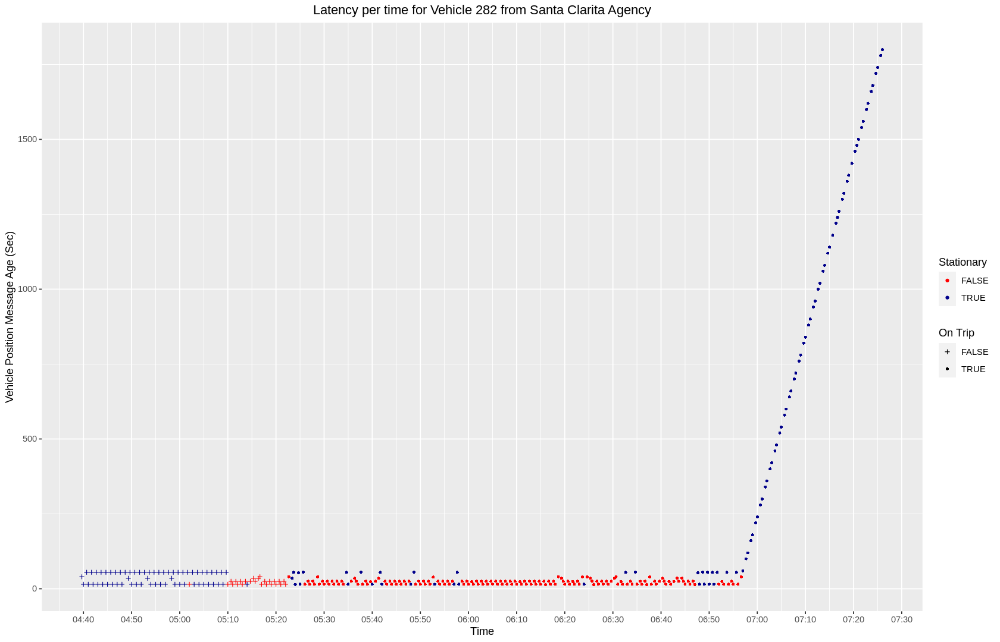

In [147]:
santaClaritaDistinct %>% 
    # filter(Agency == "Santa Clarita VehiclePositions",
    #        Vendor == "Connexionz Inc.",
    #        vehicle_label == "282") %>%
    arrange(desc(extract_ts_pasific)) %>% 
    mutate(`On Trip` = !is.na(trip_id),
           location = position_latitude + position_longitude, 
           location1 = lead(location, default = last(location)),
           Stationary = location == location1) %>% 
    ggplot(aes(extract_ts_pasific, VPLatency)) +
    geom_point(size = 1.1, aes(color = Stationary, shape = `On Trip`)) +
    xlab("Time") +
    ylab("Vehicle Position Message Age (Sec)") +
    ggtitle("Latency per time for Vehicle 282 from Santa Clarita Agency") +
    theme(plot.title = element_text(hjust = 0.5)) +
    scale_color_manual(values = c("red", "darkblue")) +
    scale_shape_manual(values = c(3, 16)) +
    scale_x_datetime( breaks = date_breaks("10 min"), 
                    labels = date_format("%H:%M", 
                                         # tz="CET"
                                        ), 
                    # expand = c(0,0)
                    )



In [141]:
santaClaritaDistinct$VPLatency %>% 
    summary()

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   14.0    15.0    25.0   187.3    55.0  1800.0 

In [148]:
Report10272 %>% 
    filter(Agency == "Santa Clarita VehiclePositions",
           Vendor == "Connexionz Inc.",
           vehicle_label == "282") %>%
    pull(VPLatency) %>% 
    summary()

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   14.0    24.0    35.0   191.8    55.0  1820.0 